In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

In [23]:
%matplotlib inline

## Задача 1
Постройте график
Назовите график
Сделайте именование оси x и оси y
Сделайте выводы

### 1.1. Скачать данные по ссылке https://www.kaggle.com/datasets/ionaskel/laptop-prices

In [24]:
df = pd.read_csv('../2/kc_house_data.csv')

In [25]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180.0,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170.0,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770.0,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050.0,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680.0,0,1987,0,98074,47.6168,-122.045,1800,7503


In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21611 non-null  float64
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

### 1.2 Изучите стоимости недвижимости

In [27]:
df['price'].describe()

count    2.161300e+04
mean     5.400881e+05
std      3.671272e+05
min      7.500000e+04
25%      3.219500e+05
50%      4.500000e+05
75%      6.450000e+05
max      7.700000e+06
Name: price, dtype: float64

In [28]:
df['price'].mode

<bound method Series.mode of 0        221900.0
1        538000.0
2        180000.0
3        604000.0
4        510000.0
           ...   
21608    360000.0
21609    400000.0
21610    402101.0
21611    400000.0
21612    325000.0
Name: price, Length: 21613, dtype: float64>

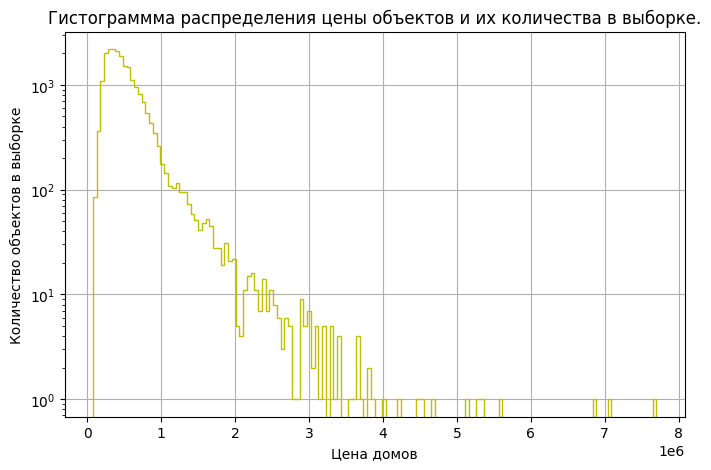

In [29]:
plt.figure(figsize=(8,5 ))
plt.hist(df['price'], color='y'
         , bins=150
         , log=True
         , histtype='step'
#         , density=True
        ) 
## сделаем 150 бинов, чтобы было видно, что дома с маленькими ценниками существуют.
## прологарифмируем количество, для отображения объектов с большим ценником.
plt.xlabel('Цена домов')
plt.ylabel('Количество объектов в выборке')
plt.title('Гистограммма распределения цены объектов и их количества в выборке.', )
plt.grid();

In [30]:
# Признак цена - непрерывная величина, для анализа непрерывной величины целесообразно использовать гистограмму
# Наибольшее количество объектов имеет цену в 0.4-0.5 * 10**6
# Присутствуют отдельные объекты с ценой до 7.6 * 10**6
# Логарифмирование шкалы количества объектов отображает на гистограмме объекты количество которых мало.

In [31]:
# одновременное логарифмирование цены и шкалы количества объектов. Показывает, что распределение 

In [32]:
#c.apply(lambda x: np.log10(x))
np.log10(df['price'])

0        5.346157
1        5.730782
2        5.255273
3        5.781037
4        5.707570
           ...   
21608    5.556303
21609    5.602060
21610    5.604335
21611    5.602060
21612    5.511883
Name: price, Length: 21613, dtype: float64

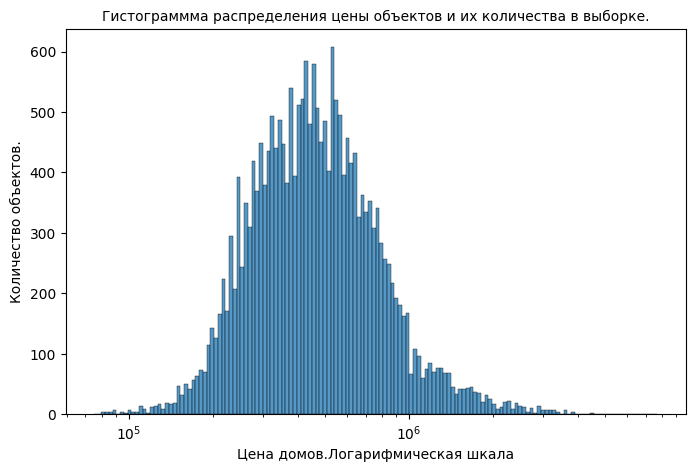

In [33]:
plt.figure(figsize=(8,5 ))
sns.histplot(data=df, x='price'
#             , hue='floors'
             , bins=150
             , log_scale=True
            );
plt.xlabel('Цена домов.Логарифмическая шкала')
plt.ylabel('Количество объектов.')
plt.title('Гистограммма распределения цены объектов и их количества в выборке.', size=10 );

In [34]:
# если прологарифмировать шкалу цены, становится наглядным, что случайная величина имеет номальное распределение.
# что позволяет применять к этой случайной величине закономерности основанные на нормальном распределении.

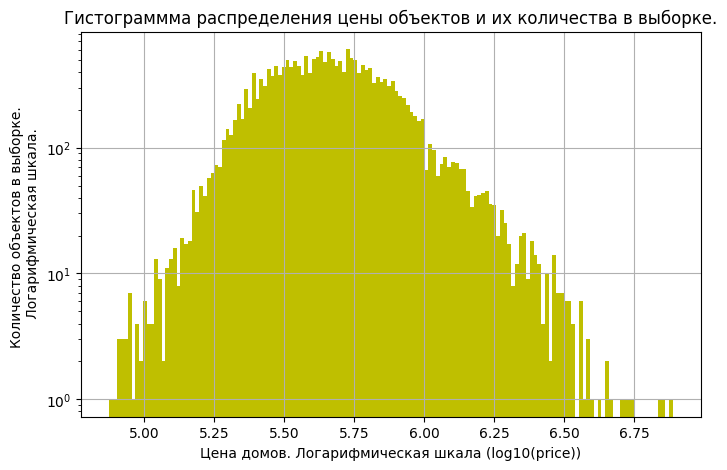

In [35]:
plt.figure(figsize=(8,5 ))
plt.hist(np.log10(df['price']), color='y'
         , bins=150
         , log=True
#         , histtype='step'
#         , density=True
        ) 
## сделаем 150 бинов, чтобы было видно, что дома с маленькими ценниками существуют.
## прологарифмируем количество, для отображения объектов с большим ценником.
plt.xlabel('Цена домов. Логарифмическая шкала (log10(price))')
plt.ylabel('Количество объектов в выборке. \n Логарифмическая шкала.')
plt.title('Гистограммма распределения цены объектов и их количества в выборке.', )
plt.grid();

In [36]:
# Логарфимирование одновременно двух шкал позовляет отобразить, как тот факт, 
# что случайная величина соответствует закону нормального распределения, так и визуализировать объекты с большой ценой.

### 1.3 Изучите распределение квадратуры жилой

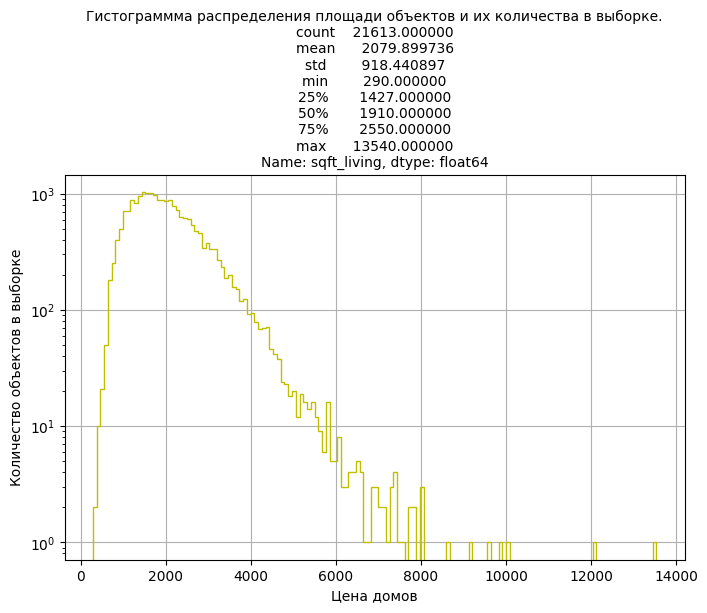

In [37]:
plt.figure(figsize=(8,5 ))
plt.hist(df['sqft_living'], color='y'
         , bins=150
         , log=True
         , histtype='step'
        ) 
## сделаем 150 бинов, чтобы было видно, что дома с маленькими ценниками существуют.
## прологарифмируем количество, для отображения объектов с большим ценником.
plt.xlabel('Цена домов')
plt.ylabel('Количество объектов в выборке')
plt.title(f'Гистограммма распределения площади объектов и их количества в выборке.'+
          f'\n{df["sqft_living"].describe()}', size=10)
plt.grid();

In [38]:
# Согласно графику наибольшее число объектов имеют площадь 1500-1800 sq.ft.
# В выборке присутствуют отдельные объекты, имеющие площадь 12 000, 13 500 sq.ft.
# Возможно это выбросы.

### 1.4 Изучите распределение года постройки

In [39]:
# Год постройки дискретная случайная величина в силу большого количества значений можно визуализировать ее,
# как через гистограмму используя интервалы, так и через столбчатую диаграмму.

In [40]:
df['yr_built'].describe()

count    21613.000000
mean      1971.005136
std         29.373411
min       1900.000000
25%       1951.000000
50%       1975.000000
75%       1997.000000
max       2015.000000
Name: yr_built, dtype: float64

In [43]:
# подготовим данные для построения диаграммы
df_count_by_yr_built = df['yr_built'].value_counts().sort_index(ascending=False).reset_index().rename(columns={"yr_built":"count", "index":"yr_built"})
df_count_by_yr_built
#df['yr_built'].value_counts()

,yr_built,count
0,2015,38
1,2014,559
2,2013,201
3,2012,170
4,2011,130
...,...,...
111,1904,45
112,1903,46
113,1902,27
114,1901,29


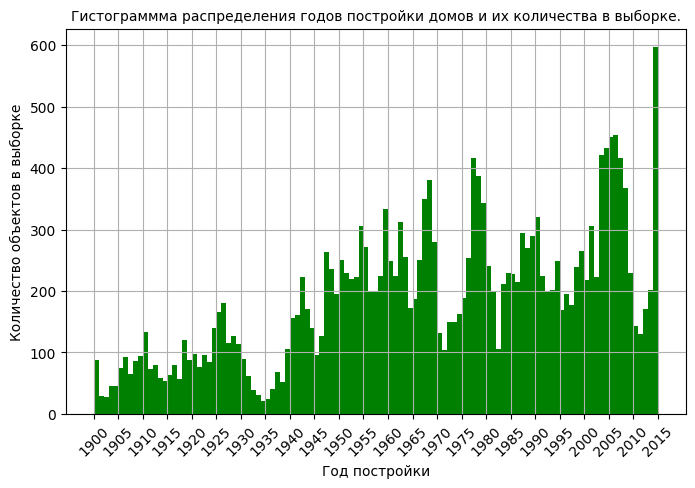

In [44]:
ticks_step = 5
ticks_label = np.arange(math.floor(df_count_by_yr_built['yr_built'].min() / ticks_step) * ticks_step,
                        math.ceil(df_count_by_yr_built['yr_built'].max() / ticks_step)   * ticks_step+1, ticks_step)
plt.figure(figsize=(8,5 ))
plt.hist(df['yr_built'], color='g'
         , bins=df['yr_built'].max() - df['yr_built'].min()
#        , log=True
        ) 
## сделаем количество бинов, равное количеству годов, когда строились объекты
## прологарифмируем количество, для отображения объектов с большим ценником.
plt.xlabel('Год постройки')
plt.ylabel('Количество объектов в выборке')
plt.title(f'Гистограммма распределения годов постройки домов и их количества в выборке.', size=10)
plt.grid()
plt.xticks(ticks=ticks_label, labels=ticks_label, rotation=45);

In [45]:
# По диаграмме видно, что количество домов в выборке по мере уменьшения их возраста увеличивается.
# По этому графику можно установить, что пики строительства домов приходились на 1978, 2009 гг.

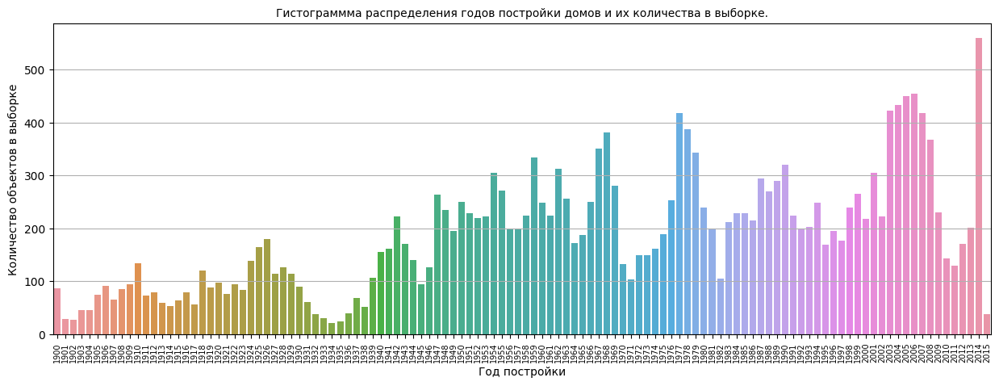

In [50]:
plt.figure(figsize=(15,5 ))
sns.barplot(x=df_count_by_yr_built['yr_built'], y=df_count_by_yr_built['count'])
plt.xticks(rotation=90, fontsize=7);
# не удалось вывести наименования с пропусками отдельных наименований как для гистограммы
plt.xlabel('Год постройки')
plt.ylabel('Количество объектов в выборке')
plt.title(f'Гистограммма распределения годов постройки домов и их количества в выборке.', size=10)
plt.grid(axis='y');


In [51]:
# Стало видно, какой год к каому стоблику привязан, но не сказать, что стало наглядее в целях EDA.

## Задача 2

### 2.1 Изучите распределение домов от наличия вида на набережную
Постройте график
Сделайте выводы

In [53]:
df_count_by_waterfront = df['waterfront']\
.value_counts().sort_index(ascending=False)\
.reset_index()\
.rename(columns={"waterfront":"count", "index":"waterfront"})\
.replace({0:'No',1:'Yes'})
df_count_by_yr_built

,yr_built,count
0,2015,38
1,2014,559
2,2013,201
3,2012,170
4,2011,130
...,...,...
111,1904,45
112,1903,46
113,1902,27
114,1901,29


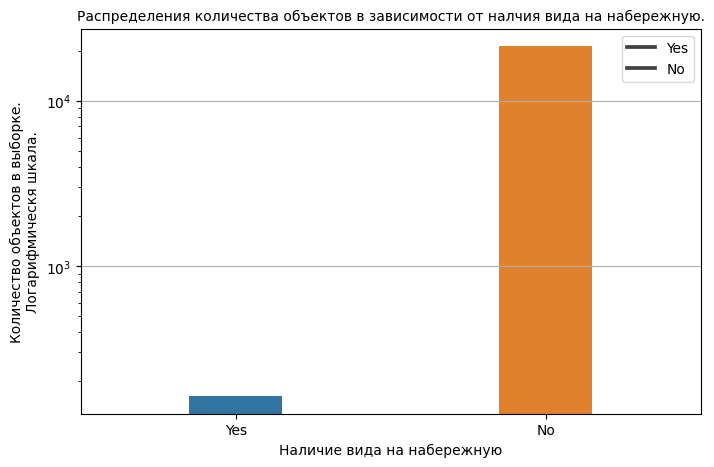

In [54]:
plt.figure(figsize=(8,5 ))
sns.barplot(x=df_counr_by_waterfront['waterfront'], y=df_counr_by_waterfront['count'], width=(0.3), log=True)
# plt.xticks(rotation=90, fontsize=7);
# не удалось вывести наименования с пропусками отдельных наименований как для гистограммы
plt.xlabel('Наличие вида на набережную')
plt.ylabel('Количество объектов в выборке.\nЛогарифмическя шкала.')
plt.title(f'Распределения количества объектов в зависимости от налчия вида на набережную.', size=10)
plt.grid(axis='y')
plt.legend(['Yes', 'No']);


In [55]:
# применили логарифмическую шкалу для более наглядного отображения количества объектов с признаком Yes

### 2.2 Изучите распределение этажей домов

In [57]:
df_count_by_floors = df['floors']\
.value_counts().sort_index(ascending=False)\
.reset_index()\
.rename(columns={"floors":"count", "index":"floors"})
df_count_by_floors

,floors,count
0,3.5,8
1,3.0,613
2,2.5,161
3,2.0,8241
4,1.5,1910
5,1.0,10680


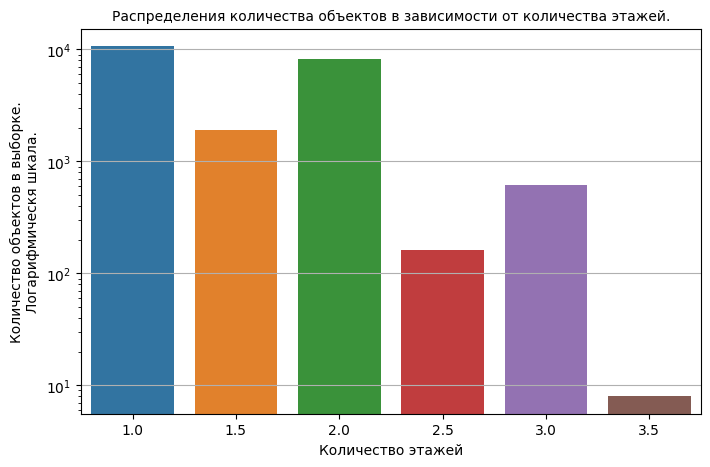

In [58]:
plt.figure(figsize=(8,5 ))
sns.barplot(x=df_count_by_floors['floors'], y=df_count_by_floors['count'], width=(0.8)
            , log=True
           )
# plt.xticks(rotation=90, fontsize=7);
# не удалось вывести наименования с пропусками отдельных наименований как для гистограммы
plt.xlabel('Количество этажей')
plt.ylabel('Количество объектов в выборке.\nЛогарифмическя шкала.')
plt.title(f'Распределения количества объектов в зависимости от количества этажей.', size=10)
plt.grid(axis='y')
# plt.legend(df_counr_by_floors['floors']);


### 2.2 Изучите распределение состояния домов

In [60]:
df_count_by_grade = \
df['grade']\
.value_counts().sort_index(ascending=False)\
.reset_index()\
.rename(columns={"grade":"count", "index":"grade"})
df_count_by_grade

,grade,count
0,13,13
1,12,90
2,11,399
3,10,1134
4,9,2615
5,8,6068
6,7,8981
7,6,2038
8,5,242
9,4,29


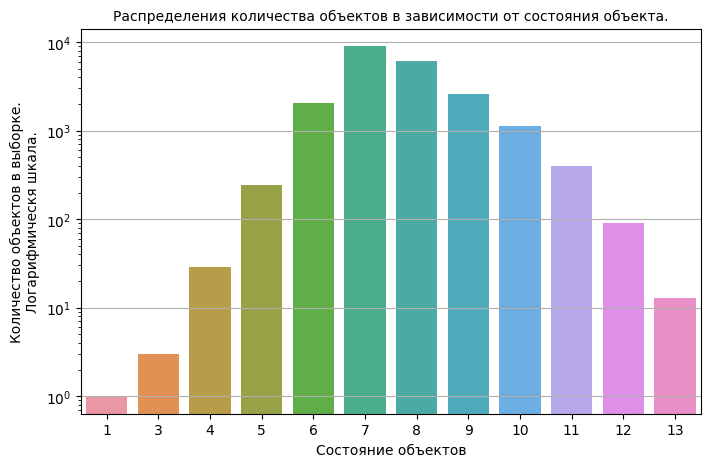

In [62]:
plt.figure(figsize=(8,5 ))
sns.barplot(x=df_count_by_grade['grade'], y=df_count_by_grade['count'], width=(0.8)
            , log=True
           )
# plt.xticks(rotation=90, fontsize=7);
# не удалось вывести наименования с пропусками отдельных наименований как для гистограммы
plt.xlabel('Состояние объектов')
plt.ylabel('Количество объектов в выборке.\nЛогарифмическя шкала.')
plt.title(f'Распределения количества объектов в зависимости от состояния объекта.', size=10)
plt.grid(axis='y')
# plt.legend(df_counr_by_floors['floors']);

In [63]:
df_count_by_grade1 = \
pd.crosstab(df['grade'], df['waterfront'])\
.reset_index()\
.sort_values(by='grade', ascending=True)\
.rename(columns={0:"No", 1:"Yes"})
df_count_by_grade1

waterfront,grade,No,Yes
0,1,1,0
1,3,3,0
2,4,29,0
3,5,238,4
4,6,2026,12
5,7,8958,23
6,8,6028,40
7,9,2590,25
8,10,1106,28
9,11,379,20


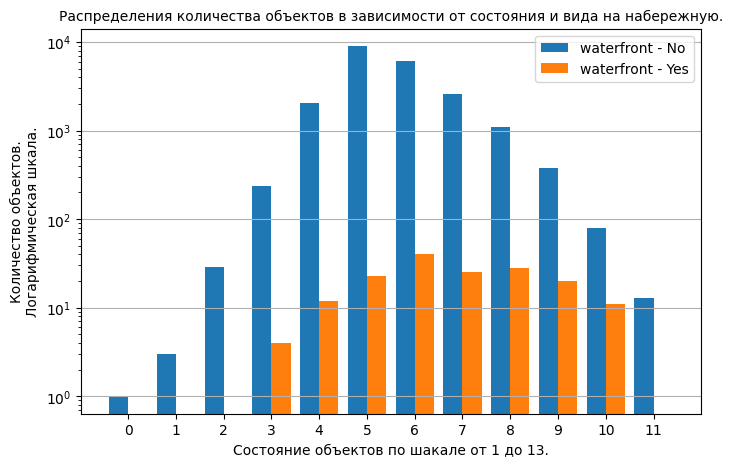

In [64]:
w = 0.4
offset = 0.2
n_ticks = np.arange(len(df_count_by_grade1['No']))

plt.figure(figsize=(8, 5))
plt.bar(n_ticks - offset, df_count_by_grade1['No'], width=w)
plt.bar(n_ticks + offset, df_count_by_grade1['Yes'], width=w)
plt.yscale('log')
plt.grid(axis='y')
plt.title(f'Распределения количества объектов в зависимости от состояния и вида на набережную.', size=10)
plt.xlabel(f'Состояние объектов по шакале от {df_count_by_grade1["grade"].min()} до {df_count_by_grade1["grade"].max()}.')
plt.ylabel(f'Количество объектов.\nЛогарифмическая шкала.')
plt.legend(['waterfront - No', 'waterfront - Yes'])
plt.xticks(n_ticks);

## Задача 3
Исследуйте, какие характеристики недвижимости влияют на стоимость недвижимости, с применением не менее 5 диаграмм из урока.
Анализ сделайте в формате storytelling: дополнить каждый график письменными выводами и наблюдениями.

In [65]:
df.condition.value_counts()

3    14031
4     5679
5     1701
2      172
1       30
Name: condition, dtype: int64

In [66]:
df.grade.value_counts()

7     8981
8     6068
9     2615
6     2038
10    1134
11     399
5      242
12      90
4       29
13      13
3        3
1        1
Name: grade, dtype: int64

In [67]:
df.floors.value_counts()

1.0    10680
2.0     8241
1.5     1910
3.0      613
2.5      161
3.5        8
Name: floors, dtype: int64

In [68]:
np.sort(df['grade'].unique())

array([ 1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13], dtype=int64)

In [69]:
# Проанализируем зависимость цены от категории объекта.
# Класс объекта - категориальный признак. Проанализируем категориальный признак построением boxplot
# по цене для каждой категории.
# Подготовим данные.
grades = list(np.sort(df['grade'].unique()))
grade_as_list = \
[df['price'][df['grade'] == grade] for grade in grades]
print(grades)
n_ticks = np.arange(min(grades), max(grades))

[1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]


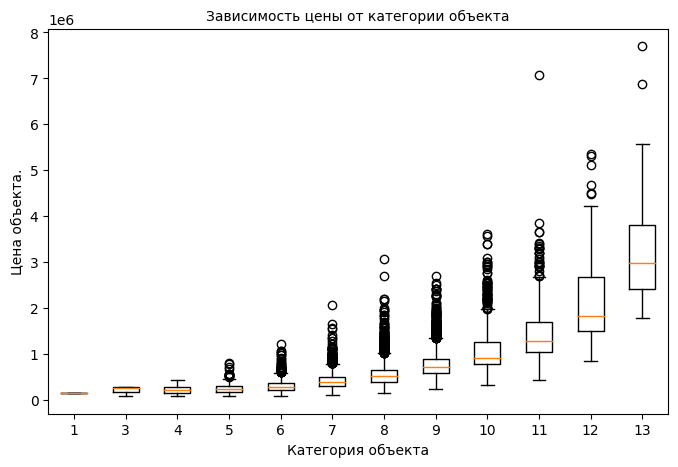

In [70]:
plt.figure(figsize=(8, 5))
plt.boxplot(grade_as_list );
plt.title(f'Зависимость цены от категории объекта', size=10)
plt.ylabel('Цена объекта.')
plt.xlabel('Категория объекта')
plt.xticks(n_ticks, grades);

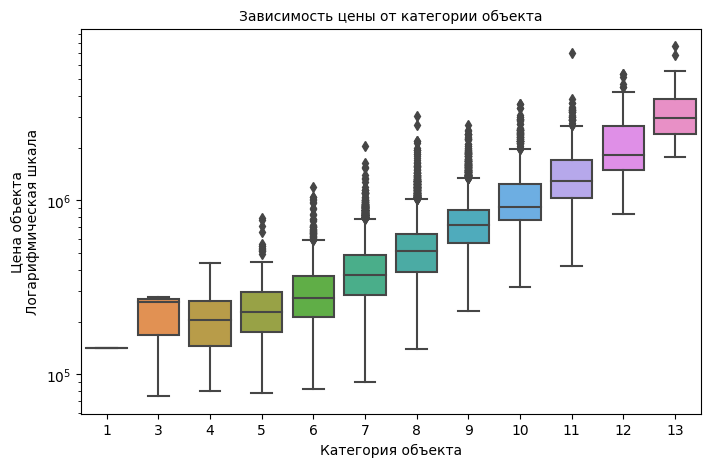

In [71]:
# Имеется прямая нелинейная зависимость. Разброс цены для обектов
# низкой категорией меньше, чем объектов с большой категорией.
# для более наглядного отображения объектов с низкой категорией применим логарифмическую шкалу цены
# при применении логарфмичской шкалы зависимость становится практически линейной (прямая линейная зависимость).
# для категорий 6, 9, 10, 11 наблюдаются выбросы нужно дополнительно провести анализ для понимания являются ли 
# выявленные аномалии выбросами или нет.
plt.figure(figsize=(8, 5))
#sns.boxplot(grade_as_list )
sns.boxplot(x='grade', y ='price', data=df) # с помощью sns анализ категориальных признаков
# выполняется значительно проще
plt.title(f'Зависимость цены от категории объекта', size=10)
plt.ylabel('Цена объекта\nЛогарифмическая шкала')
plt.xlabel('Категория объекта')
plt.yscale('log', base=10 );


In [72]:
# Проанализируем зависимость цены от категории объекта.
# Класс объекта - категориальный признак. Проанализируем категориальный признак построением boxplot
# по цене для каждой категории.
# Подготовим данные.
#floors_as_list = \
#[df['price'][df['floors'] == el] for el in np.sort(df['floors'].unique())]
np.sort(df['floors'].unique())

array([1. , 1.5, 2. , 2.5, 3. , 3.5])

Text(0.5, 0, 'Этажность объекта')

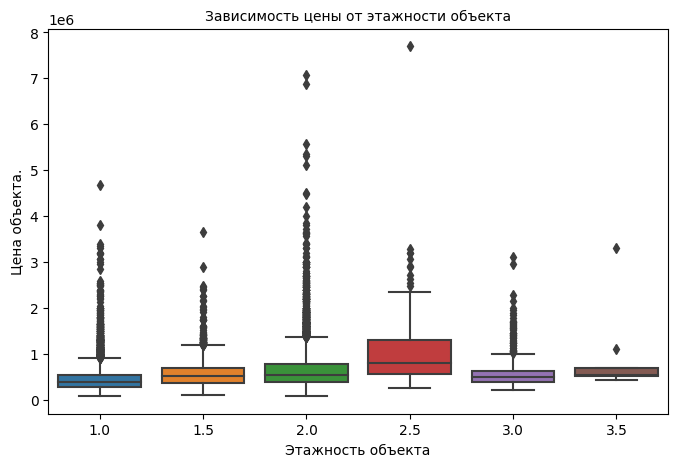

In [73]:
# Проанализируем зависимость цены этажности объекта .
# Этажность объекта - категориальный признак. Проанализируем категориальный признак построением boxplot
# по цене для каждой группы этажности объекта.
plt.figure(figsize=(8, 5))
sns.boxplot(x='floors', y ='price', data=df);
plt.title(f'Зависимость цены от этажности объекта', size=10)
plt.ylabel('Цена объекта.')
plt.xlabel('Этажность объекта')
# Разброс цены для каждой группы этажности значительный.
# Явной связи этажности с ценой объекта не наблюдается.

Text(0.5, 0, 'Вид объекта')

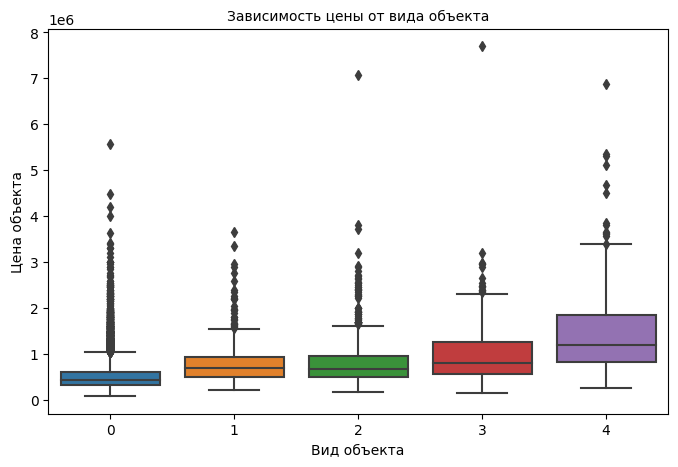

In [74]:
# Проанализируем зависимость цены от вида объекта.
# Виж объекта - категориальный признак. Проанализируем категориальный признак построением boxplot
# по цене для каждой группы вида объекта.
plt.figure(figsize=(8, 5))
sns.boxplot(x='view', y ='price', data=df);
plt.title(f'Зависимость цены от вида объекта', size=10)
plt.ylabel('Цена объекта')
plt.xlabel('Вид объекта')
# Разброс цены для каждой группы вида значительный.
# Явной связи вида объеъкта с ценой объекта не наблюдается.

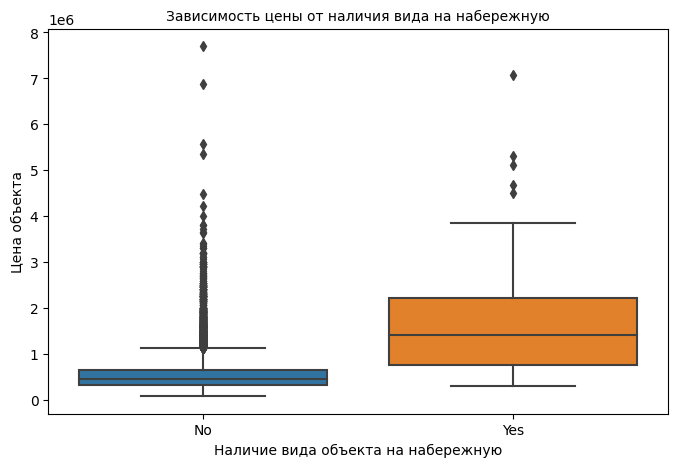

In [75]:
# Проанализируем зависимость цены от вида на набережную.
# Вид на набережную объекта - категориальный признак. Проанализируем категориальный признак построением boxplot
# по цене для каждой группы характеризующих вид на набережную.
plt.figure(figsize=(8, 5))
sns.boxplot(x='waterfront', y ='price', data=df);
plt.title(f'Зависимость цены от наличия вида на набережную', size=10)
plt.ylabel('Цена объекта')
plt.xlabel('Наличие вида объекта на набережную')
plt.xticks([0, 1], ['No','Yes']);
# Интерквартильный размах цены в группе объектов без вида на набережную меньше, чем в группе с видом на набережную.
# Наблюдаетя прямая зависимость между ценой объекта и наличиемм выда на набережную.

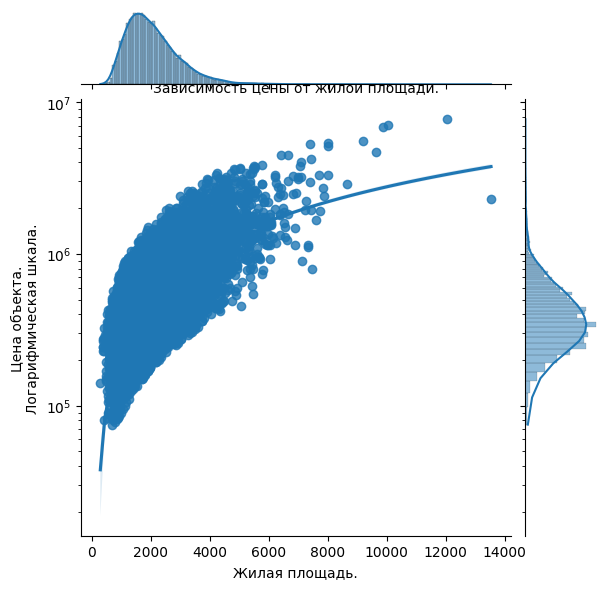

In [81]:
# Проанализируем зависимость цены от жилой площади.
sns.jointplot(x=df['sqft_living'], y=df['price'], kind='reg')
plt.title(f'Зависимость цены от жилой площади.', size=10)
plt.ylabel('Цена объекта.\nЛогарифмическая шкала.')
plt.xlabel('Жилая площадь.')
plt.yscale('log', base=10 );
# применена логарифмическую шкалу для наглядности
# наблюдается прямая зависимость между жилой площадью и ценой объекта

In [83]:
# Визуализируем карту с отображением объектов на ней с возможностью просмотра характеристик отдельных объектов
import folium

In [97]:
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.lat, point.long],
        radius=2,
        popup='\n'.join([el+' : '+str(point[el]) for el in df.columns if el != 'id'])
    ).add_to(this_map)
    
df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map

In [90]:
str(df['date'][0])

'20141013T000000'

In [96]:
print('\n'.join([el+' : '+str(df[el][0]) for el in df.columns if el != 'id']))

date : 20141013T000000
price : 221900.0
bedrooms : 3
bathrooms : 1.0
sqft_living : 1180
sqft_lot : 5650
floors : 1.0
waterfront : 0
view : 0
condition : 3
grade : 7
sqft_above : 1180.0
sqft_basement : 0
yr_built : 1955
yr_renovated : 0
zipcode : 98178
lat : 47.5112
long : -122.257
sqft_living15 : 1340
sqft_lot15 : 5650
